In [1]:
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np
import pyautogui
import time
import win32gui
import sys

133210 阴阳师-网易游戏
66938 阴阳师-网易游戏


C:\Users\15646\AppData\Local\Temp\ipykernel_6220\1034520047.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, len(snap_window), figsize=(15,5))


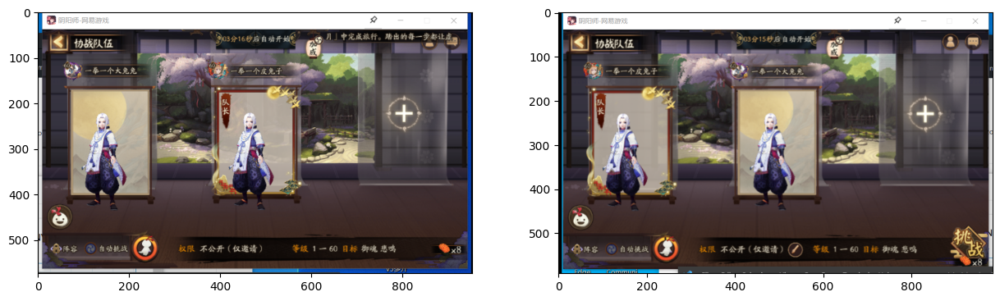

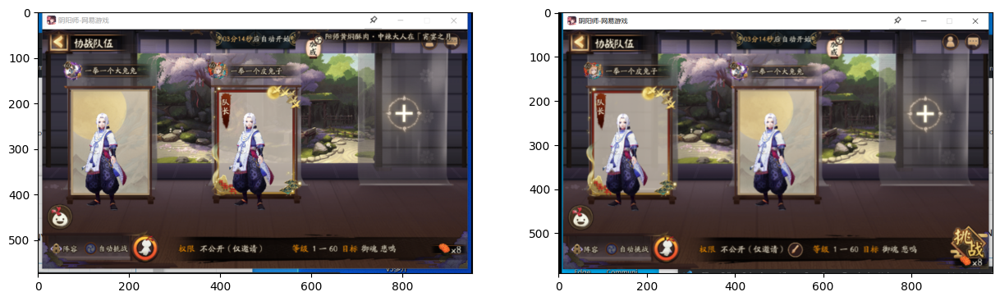

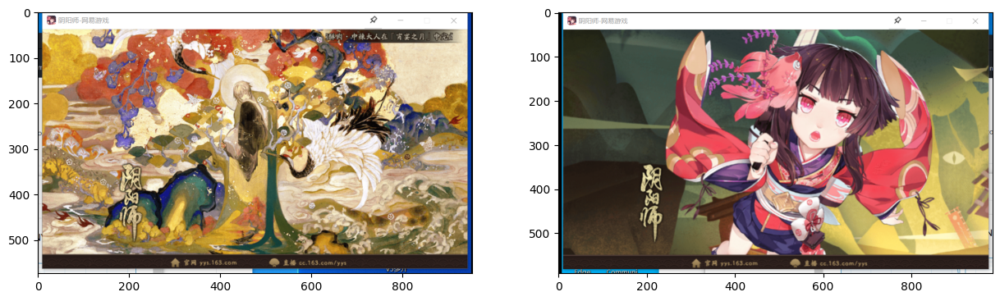

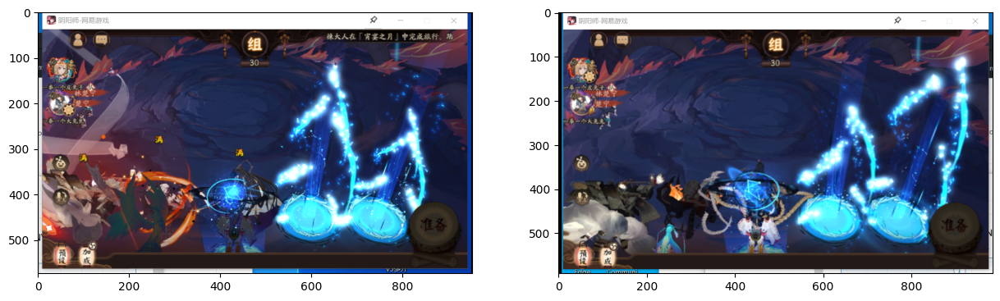

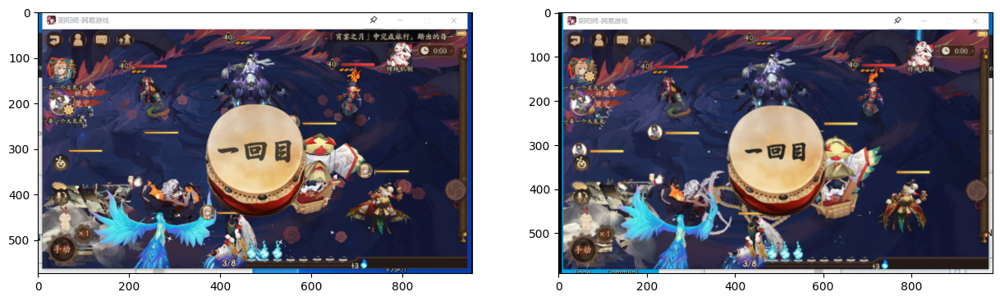

...

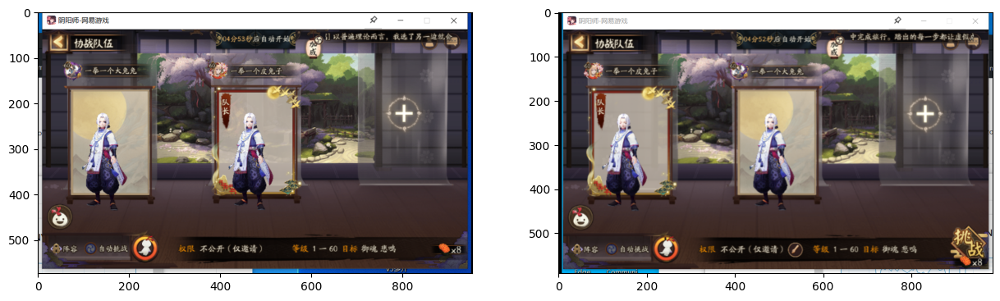

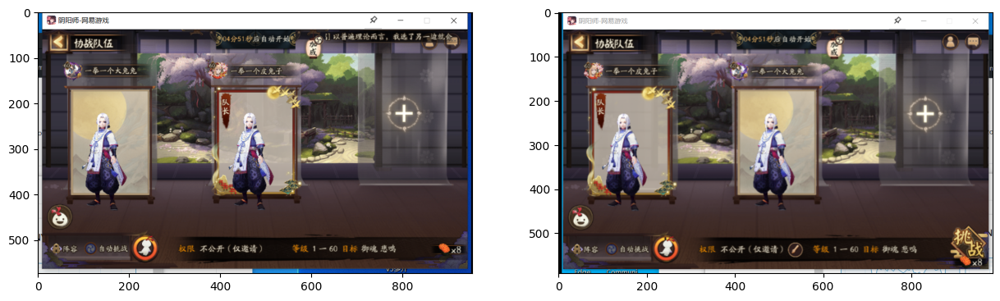

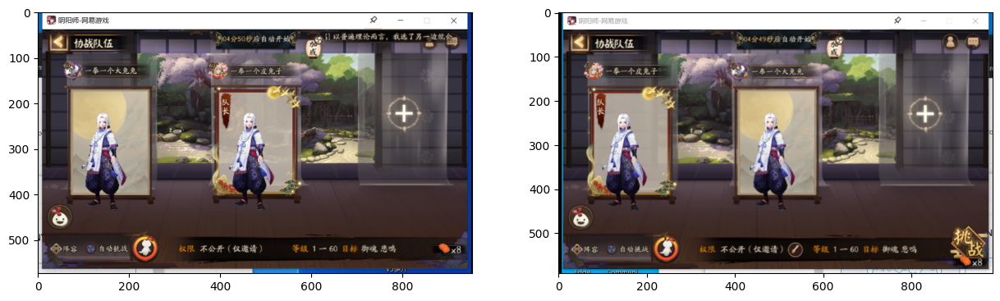

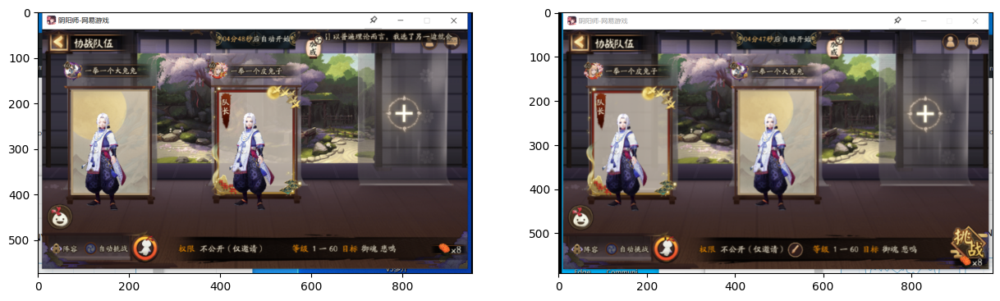

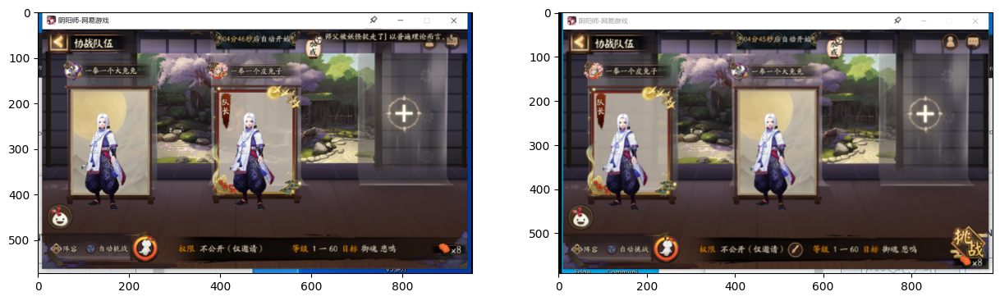

In [4]:
i = 0
path = "../test_img/03-t-"


hwnd_title = dict() # Save thread name and window name
def get_all_hwnd(hwnd, mouse):
    if win32gui.IsWindow(hwnd) and win32gui.IsWindowEnabled(hwnd) and win32gui.IsWindowVisible(hwnd):
        hwnd_title.update({hwnd: win32gui.GetWindowText(hwnd)})

win32gui.EnumWindows(get_all_hwnd, 0)

game_id = []


for h, t in hwnd_title.items():
    # if t!= "" and t == "任务管理器":
    if t!= "" and ("阴阳师" in t):
        game_id.append(h)
        print(h, t)

while i < 30:
    bboxs = []
    for id in game_id:
        bboxs.append(win32gui.GetWindowRect(id))
    # print(game_id)
    # print(bboxs)


    snap_window = []

    for bbox in bboxs:
        real_box = [bbox[0], bbox[1], bbox[2] - bbox[0], bbox[3]-bbox[1]]
        # print(real_box)
        snap = pyautogui.screenshot(region = real_box)
        snap_window.append(np.array(snap))
    
    fig, axs = plt.subplots(1, len(snap_window), figsize=(15,5))
    for idx, ax in enumerate(axs):
        # ax.set_xticks([])
        # ax.set_yticks([])
        ax.imshow(snap_window[idx],cmap="gray")

    for index in range(0, len(snap_window)):
        save_img = cv.cvtColor(snap_window[index], cv.COLOR_RGB2BGR)
        cv.imwrite(path + str(i) + "-" + str(index) + ".jpg", save_img)


    i = i + 1
    time.sleep(1.5)